#### "I wouldn't attempt to teach you what you write about in your office," said he, "and if need arose, I should come to you to ask about it. But you're so positive you know all the lore of the forest. It's difficult. Have you counted the trees?"

#### "How count the trees?" said Stepan Arkadyevitch, laughing, still trying to draw his friend out of his ill-temper. "Count the sands of the sea, number the stars." -- Anna Karenina

In [236]:
#import dependencies
#!pip install pyarrow

import string, random

import numpy as np
import pandas as pd
import geopandas as gpd

import folium
from folium import plugins
import shapely
from shapely.geometry import Point, Polygon

import matplotlib as mp
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import requests
from PIL import Image, ImageDraw
from io import BytesIO
import os

In [3]:
## LOAD DATA
#load campus tree data
df = pd.read_csv('../data/campustreedata.csv')

#remove trees with 0 lat or lon (indicating no location is recorded)
df = df[(df.LAT)!=0]
df = df[(df.LONG)!=0]

#load map zone data (this was manually created by me)
zone_gdf = gpd.read_file('../shapefiles/map.geojson')
zone_gdf = zone_gdf.to_crs("EPSG:4326")

### Training and test zone assignments
Code: 
```
zones = ['zone_' + l for l in list(string.ascii_uppercase)[:20]]
random.seed(224)
test_set = random.sample(zones, 4)
train_set = [z for z in zones if z not in test_set]
```

There are 20 zones labeled A-T
* Test Set: ['zone_T', 'zone_E', 'zone_A', 'zone_R']
* Training Set: ['zone_B', 'zone_C', 'zone_D', 'zone_F', 'zone_G', 
    'zone_H', 'zone_I', 'zone_J', 'zone_K', 'zone_L', 'zone_M', 
    'zone_N', 'zone_O', 'zone_P', 'zone_Q', 'zone_S']

- One subgroup of four zones is set aside for testing

In [4]:
# actual code that makes assignments is in text above
zones = ['zone_' + l for l in list(string.ascii_uppercase)[:20]]
test_set = ['zone_T', 'zone_E', 'zone_A', 'zone_R']
train_set = ['zone_B', 'zone_C', 'zone_D', 'zone_F', 'zone_G', 
    'zone_H', 'zone_I', 'zone_J', 'zone_K', 'zone_L', 'zone_M', 
    'zone_N', 'zone_O', 'zone_P', 'zone_Q', 'zone_S']

In [5]:
#add train/test assigment to zone_gdf
zone_gdf['in_test_set'] = zone_gdf['name'].isin(test_set)

In [6]:
#Get study area bounds
unary_map_poly = shapely.unary_union(zone_gdf['geometry'])
min_lon, min_lat, max_lon, max_lat = unary_map_poly.bounds
center_lat = (min_lat + max_lat) / 2
center_lon = (min_lon + max_lon) / 2

In [7]:
#establish plot boundary gridlines
plot_width = .0005
plot_len = .0005
lat_grids = abs(np.arange(-max_lat, -min_lat, plot_width))
lat_grids = np.append(lat_grids, (lat_grids[-1] - plot_width))
lon_grids = np.arange(min_lon, max_lon, plot_len)
lon_grids = np.append(lon_grids, (lon_grids[-1] + plot_len))

In [8]:
def make_plots(lat_grids=lat_grids, lon_grids=lon_grids):
    plots_df = gpd.GeoDataFrame(columns=['plot_id', 'plot_geom', 'zone_id']) #, 'tree_ids', 'tree_locs', 'image_data'
    plotlist = []
    plot_ids = []
    for i in range(len(lat_grids)-1):
        for j in range(len(lon_grids)-1):
            # make plot geom object
            x1 = lat_grids[i]
            x2 = lat_grids[i + 1]
            y1 = lon_grids[j]
            y2 = lon_grids[j + 1]
            r = [(y1,x1),(y2,x1),(y2,x2),(y1,x2)]
            p = Polygon(r)
            plotlist.append(p)
            #make plot id
            pid = 'X' + str(i).zfill(2) + '-Y' + str(j).zfill(2)
            plot_ids.append(pid)
    #add data to dataframe
    plots_df['plot_geom'] = plotlist
    plots_df['plot_id'] = plot_ids
    plots_df = plots_df.set_geometry('plot_geom')
    plots_df.set_crs(epsg=4326, inplace=True)
    return plots_df

In [9]:
#Makes plot geoms and plots dataframe
plots_df = make_plots()

In [10]:
# removes plots that are outside the study zones
intersects_zones = []
for row in plots_df.iterrows():
    p = row[1].iloc[1]
    x = p.intersects(unary_map_poly)
    
    intersects_zones.append(x)
plots_df['intersects_zones'] = intersects_zones
plots_df = plots_df[plots_df['intersects_zones'] == True]
plots_df = plots_df.drop(columns=['intersects_zones'])
plots_df.sample()

,plot_id,plot_geom,zone_id
1965,X23-Y33,"POLYGON ((-84.48769 42.7241, -84.48719 42.7241...",NaN


In [11]:
#Given gps coordinates, find the plot id. 
#This is much faster than looping through every plot for every tree with shapely.
def coords_to_plot_id(lat, long, lat_grids=lat_grids, lon_grids=lon_grids):
    y = np.searchsorted(lon_grids, long)
    x = len(lat_grids) - np.searchsorted(lat_grids[::-1], lat, side='right') - 1
    pid = 'X' + str(x).zfill(2) + '-Y' + str(y).zfill(2)
    return pid

#example
pid = coords_to_plot_id(df.iloc[10000]['LAT'], df.iloc[10000]['LONG'])
pid

'X38-Y19'

In [12]:
#Assigns plots to study zones
#chatgpt 4o debugged these functions for me
def find_zone(plot, zone_gdf=zone_gdf, zones=zones):
    best_zone = None
    # Create dictionary with zone_x as keys and 0s for values
    zone_overlap_dict = {z: 0 for z in zones}
    for i in range(len(zone_gdf)):
        if plot.intersects(zone_gdf['geometry'][i]):
            # What % of plot is in the zone it intersects with?
            int_area = plot.intersection(zone_gdf['geometry'][i]).area
            overlap = int_area / plot.area
            zone_overlap_dict[zone_gdf['name'][i]] = overlap
    
    # Check if plot has reasonable overlap with zones
    if max(zone_overlap_dict.values()) >= 0.25:
        best_zone = max(zone_overlap_dict, key=zone_overlap_dict.get)  # best_zone is highest match
    else:
        best_zone = None
    
    return best_zone

def assign_plots(plots_df=plots_df, zone_gdf=zone_gdf, zones=zones):
    plot_index_list = list(plots_df.index)
    zone_ids = []
    for p in plot_index_list:
        plot = plots_df.plot_geom[p]
        z = find_zone(plot=plot, zone_gdf=zone_gdf, zones=zones)
        zone_ids.append(z)
    return zone_ids

In [32]:
#Assigns plots to study zones
plots_df.zone_id = assign_plots()
plots_df.sample()

,plot_id,plot_geom,zone_id
3260,X38-Y68,"POLYGON ((-84.47019 42.7166, -84.46969 42.7166...",zone_S


In [36]:
plots_df

,plot_id,plot_geom,zone_id
33,X00-Y33,"POLYGON ((-84.48769 42.7356, -84.48719 42.7356...",None
34,X00-Y34,"POLYGON ((-84.48719 42.7356, -84.48669 42.7356...",None
35,X00-Y35,"POLYGON ((-84.48669 42.7356, -84.48619 42.7356...",zone_B
36,X00-Y36,"POLYGON ((-84.48619 42.7356, -84.48569 42.7356...",zone_B
37,X00-Y37,"POLYGON ((-84.48569 42.7356, -84.48519 42.7356...",zone_B
...,...,...,...
3996,X47-Y48,"POLYGON ((-84.48019 42.7121, -84.47969 42.7121...",zone_O
3997,X47-Y49,"POLYGON ((-84.47969 42.7121, -84.47919 42.7121...",zone_O
3998,X47-Y50,"POLYGON ((-84.47919 42.7121, -84.47869 42.7121...",zone_O
3999,X47-Y51,"POLYGON ((-84.47869 42.7121, -84.47819 42.7121...",zone_O


In [13]:
#finds zone and plot geoms and names for each tree
def find_tree_plots(tree_df = df, plots_df=plots_df, zone_gdf=zone_gdf, lat_grids=lat_grids, lon_grids=lon_grids): #chatgpt 4o helped write parts of this function
    tree_index = list(tree_df.index)
    plot_geoms = plots_df.plot_geom
    zone_geoms = zone_gdf.geometry
    
    #convert df to geodf with a Point for each tree
    tree_points = [Point(xy) for xy in zip(tree_df['LONG'], df['LAT'])]
    trees_gdf = gpd.GeoDataFrame(tree_df, geometry=tree_points)
    trees_gdf.set_crs("EPSG:4326", inplace=True)
    trees_gdf = trees_gdf.rename_geometry("GPS_Point")
    
    #initiate data lists to add to future columns Plot, Plot_ID, Zone, and Zone_ID
    Zone_ID, Plot_ID = [], []
    
    #For each tree, get plot and zone (if any)
    for index, row in trees_gdf.iterrows(): #FOR EACH TREE
        
        #initiate variables we want for each tree 
        # (tree zone, tree plot, tree zone ID, tree plot ID)
        tzi, tpi = None, None
        
        # A. get the tree's zone
        for i, z in zone_gdf.iterrows(): #FOR EACH ZONE
            if z['geometry'].contains(row['GPS_Point']):
                tzi = z['name']
        Zone_ID.append(tzi)
        
        # B. get the tree's plot
        tpi = coords_to_plot_id(row['LAT'], row['LONG'])
        Plot_ID.append(tpi)
            
    #add our new columns to the trees dataframe
    trees_gdf['Zone_ID'] = Zone_ID
    trees_gdf['Plot_ID'] = Plot_ID
    
    return trees_gdf #return new trees dataframe

In [14]:
#Make trees_gdf!!! Important data
#takes a minute
trees_gdf = find_tree_plots()

In [39]:
## Export plot training and test data 
# 1. split plots
plots_gdf_train = plots_df[plots_df['zone_id'].isin(train_set)]
plots_gdf_test = plots_df[plots_df['zone_id'].isin(test_set)]

trees_gdf_train = trees_gdf[trees_gdf['Zone_ID'].isin(train_set)]
trees_gdf_test = trees_gdf[trees_gdf['Zone_ID'].isin(test_set)]
# 2. write out files to data
#plots_gdf_train.to_file("../data/plot_data_train.gpkg", driver="GPKG")
#plots_gdf_test.to_file("../data/plot_data_test.gpkg", driver="GPKG")

# data above, mapping below

In [40]:
# adds a dot to folium map m given gps coordinates
def add_tree_dot(m, lat, lon):
    r=2
    folium.CircleMarker(
        location=[lat, lon],
        radius=r,
        color="black",
        stroke=False,
        fill=True,
        fill_opacity=0.4,
        opacity=1,
        popup=(lat,lon),
        tooltip=(lat,lon),
    ).add_to(m)

In [105]:
# shows map of plots and zones but they are all blue so it's confusing
testmap = folium.Map(location=[center_lat, center_lon], zoom_start=13)
'''        
folium.Rectangle(
    bounds=[[min_lat, min_lon], [max_lat, max_lon]],
    color='black'
).add_to(testmap)

#add plots
folium.GeoJson(plots_gdf_train).add_to(testmap)
#add zones
folium.GeoJson('../shapefiles/map.geojson').add_to(testmap)
'''
folium.TileLayer(
    tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
    attr='Esri, DigitalGlobe, GeoEye, Earthstar Geographics, CNES/Airbus DS, USDA, USGS, AeroGRID, IGN, and the GIS User Community',
    name='Esri WorldImagery'
).add_to(testmap)
testmap

In [19]:
# Create a map centered on the calculated center
def make_tts_map(df=df):
    #create map
    map_center = folium.Map(location=[center_lat, center_lon], zoom_start=14)
    #add dots for all the trees
    for row in df.iterrows():
        add_tree_dot(map_center, row[1]['LAT'], row[1]['LONG'])
        
    return map_center
map_center = make_tts_map(df)
folium.GeoJson('../shapefiles/map.geojson').add_to(map_center)
map_center

- For cross-validation with the four training subgroups, train on 3 (12) leave test on 1 (4) and rotate through. Can shuffle training groups as well for additional cross-val. Idk how long this stuff will take to run. 
- I would like a summary fig of how large the zones are, which are assigned to what, and how many trees and acres are in each one. 
- Divide into 5 subgroups of 4 zones each (one is already set aside for testing)

In [41]:
x_pix_len = 218
y_pix_len = 218

def get_plot_images(gdf, limit=None):
    count = 0
    for i, row in gdf.iterrows():
        poly = row['plot_geom']
        plot_id = row['plot_id']
        minx, miny, maxx, maxy = poly.bounds
        esri_url = f"https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/export?bbox={minx},{miny},{maxx},{maxy}&bboxSR=4326&imageSR=4326&size={x_pix_len},{y_pix_len}&f=image"
        response = requests.get(esri_url)  #written by gpt 4o
        filename = '../Plot_Images/train/' + plot_id + '.png'
        if response.status_code == 200:
            img = Image.open(BytesIO(response.content))
            img.save(filename)
        else:
            print("Failed to retrieve plot image " + plot_id + ".")
        count += 1
        if count % 100 == 0:
            print("Loaded image", count, "of", len(gdf), "...")
        if count == limit:
            break
    return(img, "Done!")

In [24]:
#get_plot_images(plots_gdf_train, limit=1)

(<PIL.PngImagePlugin.PngImageFile image mode=P size=218x218>, 'Done!')

#### Get YOLO-formatted tree/plot label data:
Relative X location, relative Y location, rel width, rel height, class

In [42]:
def get_relative_coordinates(point, rectangle): #function written by chatgpt. 
    # Get the bounds of the rectangle
    minx, miny, maxx, maxy = rectangle.bounds
    
    # Get the coordinates of the point
    px, py = point.x, point.y
    
    # Calculate the relative x and y coordinates
    relative_x = abs((px - minx) / (maxx - minx)) #??? check this when less tired
    relative_y = (py - miny) / (maxy - miny)
    
    return relative_x, relative_y

In [43]:
def get_tree_yolo_data(points_gdf, poly_gdf):
    REL_X = []
    REL_Y = []
    result_df = points_gdf.copy()
    
    for i, row in points_gdf.iterrows():
        pt = row['GPS_Point']
        pid = row['Plot_ID']
        #print(i, pid, row['FID'])
        if pid in poly_gdf['plot_id'].values:
            pgeo = poly_gdf.loc[poly_gdf['plot_id'] == pid]['plot_geom'].values[0]
            rel_x, rel_y = get_relative_coordinates(pt, pgeo)
        else:
            rel_x, rel_y = None, None
        REL_X.append(rel_x)
        REL_Y.append(rel_y)
    result_df['REL_X'] = REL_X
    result_df['REL_Y'] = REL_Y
    result_df['REL_HEIGHT'] = .15
    result_df['REL_WIDTH'] = .15
    result_df['CLASS_0'] = 0
    return result_df

In [44]:
tree_gdf_train_yolo = get_tree_yolo_data(trees_gdf_train, plots_gdf_train)

### View one set of plot training data to make sure that it's actually labeled correctly.

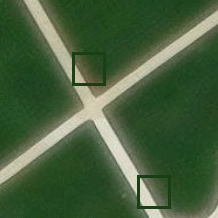

In [254]:
# in format: <class_id> <x_center> <y_center> <width> <height>
# out format: [(left, top, right, bottom), 
def lab_to_bbox(row, imgsz=218): #assumes square image
    r = row * imgsz

    left = round(np.clip((r[1] - (0.5*r[3])), 0, imgsz))
    top = round(np.clip((r[2] - (0.5 * r[4])), 0, imgsz))
    right = round(np.clip((r[1] + (0.5*r[3])), 0, imgsz))
    bottom = round(np.clip((r[2] + (0.5 * r[4])), 0, imgsz))
    
    bbox = (left, top, right, bottom)
    return(bbox)

def view_annotations(plotID, imgdir, labdir):
    #get filepaths for image and labels of plot
    lfp = labdir + '/' + plotID + '.txt'
    ifp = imgdir + '/' + plotID + '.png'

    #get bounding boxes
    bounding_boxes = []
    if os.path.getsize(lfp) > 0:
        ldf = pd.read_csv(lfp, sep = ' ', header=None)
        for i, row in ldf.iterrows():
            bbox = lab_to_bbox(row)
            bounding_boxes.append(bbox)
    else:
        print("Label file is empty. Maybe this image does not have notable features.")

    #get image and add bounding boxes to it
    image = Image.open(ifp)
    draw = ImageDraw.Draw(image)
    for box in bounding_boxes:
        draw.rectangle(box, width=3)
    
    return image

view_annotations(plotID='X05-Y37', imgdir='../Plot_Images/train', labdir='../Plot_Labels/train')

### Make and export plot labels

In [67]:
def make_plot_labels_4_yolo(trees_df=tree_gdf_train_yolo, plots_df=plots_gdf_train, limit=None):
    c = 0
    if limit is None:
        limit = len(plots_df)
    for i, row in plots_df.iterrows():
        pid = row['plot_id']
        labels = trees_df.loc[trees_df['Plot_ID'] == pid][['CLASS_0', 'REL_X', 'REL_Y', 'REL_WIDTH', 'REL_HEIGHT']]
        filename = "../Plot_Labels/train/" + pid + ".txt"
        labels.to_csv(filename, sep = ' ', index=False, header=False)
        c += 1
        if c > limit:
            break
    #and throw in a .yaml just for good measure
    return 'Done!'

In [68]:
#make_plot_labels_4_yolo()

'Done!'

### Make txt files listing the plots for each zone

In [77]:
plots_df.sample()

,plot_id,plot_geom,zone_id
885,X10-Y45,"POLYGON ((-84.48169 42.7306, -84.48119 42.7306...",zone_C


In [93]:
def export_plots_per_zone(zones=zones, plots_df=plots_df):
    for z in zones:
        zplots = plots_df.loc[plots_df['zone_id'] == z][['plot_id']]
        filename = "../Zone_Plots/" + z + ".txt"
        zplots.to_csv(filename, index=False, header=False)
    return("Done!")

In [94]:
#export_plots_per_zone()

'Done!'